In [1]:
from astropy.io import fits

import jax
import jax.numpy as jnp
import matplotlib.pyplot as plt
import numpy as np

import os
os.environ['XLA_PYTHON_CLIENT_MEM_FRACTION'] = '0.15'

jax.config.update("jax_enable_x64", True)

## Reading and Displaying Fits File

In [2]:
def process_image(image, scale_factor=1, offset=1):
    scaled_image = (image[::scale_factor, ::scale_factor])[1::, 1::]
    cropped_image = image[70:210, 70:210]
    def safe_float32_conversion(value):
        try:
            return np.float32(value)
        except (ValueError, TypeError):
            print("This value is unjaxable: " + str(value))
    fin_image = np.nan_to_num(cropped_image)
    fin_image = np.vectorize(safe_float32_conversion)(fin_image)
    return fin_image

Filename: Fits/aumic_H_pol.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU     482   ()      
  1  SCI           1 ImageHDU       140   (281, 281, 4)   float32   
  2  DQ            3 ImageHDU        64   (281, 281, 2)   uint8   


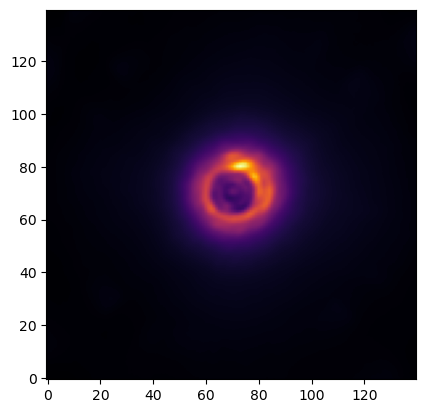

In [3]:
fits_image_filepath = "Fits/aumic_H_pol.fits"
hdul = fits.open(fits_image_filepath)

#Displays File Info
hdul.info()

# Gets Image
image = process_image(hdul['SCI'].data[0,:,:])

# Displays Image
plt.imshow(image, origin='lower', cmap='inferno')

## Displaying All Fits Files

In [4]:

fnames = os.listdir("Fits/")
print(fnames)

scale_factor = 1
images = []
ignore_fits = ['systempsf.fits']

for fname in fnames:
    if(fname in ignore_fits):
        continue
    hdul = fits.open("Fits/"+fname)
    image = process_image(hdul['SCI'].data[1,:,:])
    images.append(image)

['hd145560_H_pol.fits', 'hd146897_H_pol.fits', 'ceant_H_pol.fits', 'hd61005_H_pol.fits', 'systempsf.fits', 'hd111520_H_pol.fits', 'hd115600_H_pol.fits', 'hd129590_H_pol.fits', 'hd117214_H_pol.fits', 'betpic_H_pol.fits', 'hd35841_H_pol.fits', 'hd30447_H_pol.fits', 'hr7012_H_pol.fits', 'hd32297_H_pol.fits', 'hd110058_H_pol.fits', 'hd111161_H_pol.fits', 'hd157587_H_pol.fits', 'hr4796a_H_pol.fits', 'aumic_H_pol.fits', 'hd143675_H_pol.fits', 'hd131835_H_pol.fits', 'hd106906_H_pol.fits', 'hd114082_H_pol.fits', 'hd191089_H_pol.fits', 'hd156623_H_pol.fits']


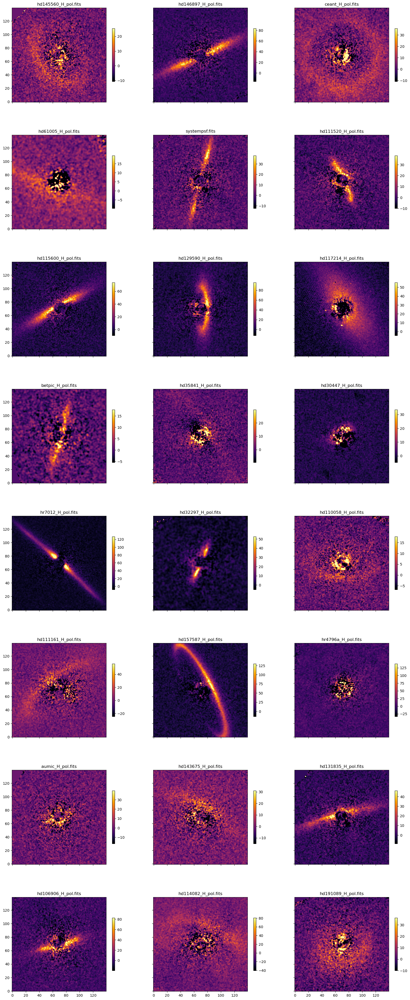

In [5]:
fig, axes = plt.subplots(8,3, sharex=True, sharey=True, figsize = (20,50))

for i in range(0, 8):
    for j in range(0, 3):

        ## Get a good scaling for the images
        y, x = np.indices(images[3*i+j].shape)
        y -= 70
        x -= 70 
        rads = np.sqrt(x**2+y**2)
        mask = (rads > 12)

        vmin = np.percentile(images[3*i+j][mask], 1)
        vmax = np.percentile(images[3*i+j][mask], 99.9)

        im = axes[i][j].imshow(images[3*i+j], origin='lower', cmap='inferno',vmin=vmin, vmax=vmax)
        axes[i][j].set_title(fnames[3*i+j])
        plt.colorbar(im,ax=axes[i][j], shrink=0.5)

## Fitting Disk Models to Fits Images

In [6]:
from disk_utils_jax import jax_model_all_1d, jax_model
from regression import log_likelihood_1d_pos_all_pars_spline
from scipy.optimize import minimize
from SLD_utils import *

In [7]:
# Creating error map
def create_circular_err_map(image_shape, iradius, oradius, noise_level):
    err_map = jnp.zeros(image_shape)
    center = image_shape[0]/2
    y, x = jnp.ogrid[:image_shape[0], :image_shape[1]]
    distance = jnp.sqrt((x - center) ** 2 + (y - center) ** 2)  
    err_map = jnp.where(distance <= oradius, noise_level, 1e8)
    err_map = jnp.where(distance >= iradius, err_map, 1e8)
    return err_map

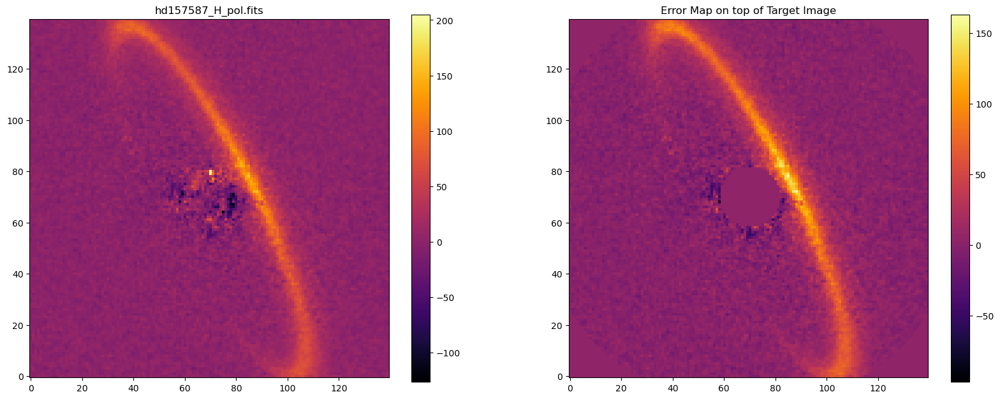

In [8]:
target_image = jnp.asarray(images[16])

fig, axes = plt.subplots(1, 2, figsize=(20,10))

im = axes[0].imshow(target_image, origin='lower', cmap = 'inferno')
axes[0].set_title(fnames[16])
plt.colorbar(im, ax=axes[0], shrink=0.75)

noise_level = 5
err_map = create_circular_err_map(target_image.shape, 12, 83, noise_level)
overlayed_image = jnp.where(err_map == 1e8, noise_level, target_image)
im = axes[1].imshow(overlayed_image, origin='lower', cmap = 'inferno')
axes[1].set_title("Error Map on top of Target Image")
plt.colorbar(im, ax=axes[1], shrink=0.75)

In [9]:
'''
# Parameters
disk_params = {}
disk_params['inclination'] = 40. #In degrees
disk_params['position_angle'] = 50. #In Degrees
disk_params['alpha_in'] = 8. #The inner power law
disk_params['alpha_out'] = -5. #The outer power law
disk_params['flux_scaling'] = 1e6
disk_params['sma'] = 30. #This is the semi-major axis of the model in astronomical units. 
#To get this in pixels, divide by the distance to the star, to get it in arcseconds. To get it in pixeks, divide by the pixel scale.

disk_params_1d = np.array([disk_params['alpha_in'], disk_params['alpha_out'], disk_params['sma'], disk_params['inclination'],
                           disk_params['position_angle']])
spline_params_1d= jnp.full(6, 0.05)   # random knot y-values
all_pars_spline = jnp.concatenate([disk_params_1d, spline_params_1d])'''

"\n# Parameters\ndisk_params = {}\ndisk_params['inclination'] = 40. #In degrees\ndisk_params['position_angle'] = 50. #In Degrees\ndisk_params['alpha_in'] = 8. #The inner power law\ndisk_params['alpha_out'] = -5. #The outer power law\ndisk_params['flux_scaling'] = 1e6\ndisk_params['sma'] = 30. #This is the semi-major axis of the model in astronomical units. \n#To get this in pixels, divide by the distance to the star, to get it in arcseconds. To get it in pixeks, divide by the pixel scale.\n\ndisk_params_1d = np.array([disk_params['alpha_in'], disk_params['alpha_out'], disk_params['sma'], disk_params['inclination'],\n                           disk_params['position_angle']])\nspline_params_1d= jnp.full(6, 0.05)   # random knot y-values\nall_pars_spline = jnp.concatenate([disk_params_1d, spline_params_1d])"

In [10]:
'''# Have to input spline parameters like this for the method to work
init_disk = jax_model_all_1d(DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, all_pars_spline[0:5],
                                            InterpolatedUnivariateSpline_SPF.pack_pars(all_pars_spline[5:]), disk_params['flux_scaling'])

#plt.imshow(init_disk, origin='lower', cmap='inferno')
#plt.title("Initial Guess")'''

'# Have to input spline parameters like this for the method to work\ninit_disk = jax_model_all_1d(DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, all_pars_spline[0:5],\n                                            InterpolatedUnivariateSpline_SPF.pack_pars(all_pars_spline[5:]), disk_params[\'flux_scaling\'])\n\n#plt.imshow(init_disk, origin=\'lower\', cmap=\'inferno\')\n#plt.title("Initial Guess")'

In [11]:
'''print(log_likelihood_1d_pos_all_pars_spline(all_pars_spline, DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, 
                        disk_params['flux_scaling'], target_image, err_map))'''

"print(log_likelihood_1d_pos_all_pars_spline(all_pars_spline, DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, \n                        disk_params['flux_scaling'], target_image, err_map))"

In [12]:
'''llp = lambda x: log_likelihood_1d_pos_all_pars_spline(x, DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, 
                        disk_params['flux_scaling'], target_image, err_map, pxInArcsec=0.01414)

opt = {'disp':True,'maxiter':3000}
soln_spline = minimize(llp, all_pars_spline, options=opt, method = None)

print(soln_spline)'''

"llp = lambda x: log_likelihood_1d_pos_all_pars_spline(x, DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, \n                        disk_params['flux_scaling'], target_image, err_map, pxInArcsec=0.01414)\n\nopt = {'disp':True,'maxiter':3000}\nsoln_spline = minimize(llp, all_pars_spline, options=opt, method = None)\n\nprint(soln_spline)"

In [13]:
'''# Have to input spline parameters like this for the method to work
disk_image_fit_spline = jax_model_all_1d(DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, soln_spline.x[0:5],
                                            InterpolatedUnivariateSpline_SPF.pack_pars(soln_spline.x[5:]), disk_params['flux_scaling'],
                                            pxInArcsec=0.01414)'''

"# Have to input spline parameters like this for the method to work\ndisk_image_fit_spline = jax_model_all_1d(DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, soln_spline.x[0:5],\n                                            InterpolatedUnivariateSpline_SPF.pack_pars(soln_spline.x[5:]), disk_params['flux_scaling'],\n                                            pxInArcsec=0.01414)"

In [14]:
'''fig, axes = plt.subplots(1,3, figsize=(20,10))

im = axes[0].imshow(disk_image_fit_spline, origin='lower', cmap='inferno')
axes[0].set_title("Spline Fit")
plt.colorbar(im, ax=axes[0], shrink=0.75)

im = axes[1].imshow(target_image, origin='lower', cmap='inferno')
axes[1].set_title("Target Image")
plt.colorbar(im, ax=axes[1], shrink=0.75)

im = axes[2].imshow(target_image-disk_image_fit_spline, origin='lower', cmap='inferno')
axes[2].set_title("Target Image - Spline Fit")
plt.colorbar(im, ax=axes[2], shrink=0.75)'''

'fig, axes = plt.subplots(1,3, figsize=(20,10))\n\nim = axes[0].imshow(disk_image_fit_spline, origin=\'lower\', cmap=\'inferno\')\naxes[0].set_title("Spline Fit")\nplt.colorbar(im, ax=axes[0], shrink=0.75)\n\nim = axes[1].imshow(target_image, origin=\'lower\', cmap=\'inferno\')\naxes[1].set_title("Target Image")\nplt.colorbar(im, ax=axes[1], shrink=0.75)\n\nim = axes[2].imshow(target_image-disk_image_fit_spline, origin=\'lower\', cmap=\'inferno\')\naxes[2].set_title("Target Image - Spline Fit")\nplt.colorbar(im, ax=axes[2], shrink=0.75)'

In [15]:
'''print(log_likelihood_1d_pos_all_pars_spline(all_pars_spline, DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, 
                        disk_params['flux_scaling'], target_image, err_map, PSFModel=EMP_PSF, pxInArcsec=0.01414))'''

"print(log_likelihood_1d_pos_all_pars_spline(all_pars_spline, DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, \n                        disk_params['flux_scaling'], target_image, err_map, PSFModel=EMP_PSF, pxInArcsec=0.01414))"

In [16]:
'''from optimize import quick_optimize, quick_image

err_map = create_circular_err_map(target_image.shape, 12, 83, 5)
soln = quick_optimize(target_image, err_map, method = None, iters = 2000, PSFModel=EMP_PSF, pxInArcsec=0.01414)

disk_image_fit_spline = quick_image(soln, PSFModel=EMP_PSF, pxInArcsec=0.01414)'''

'from optimize import quick_optimize, quick_image\n\nerr_map = create_circular_err_map(target_image.shape, 12, 83, 5)\nsoln = quick_optimize(target_image, err_map, method = None, iters = 2000, PSFModel=EMP_PSF, pxInArcsec=0.01414)\n\ndisk_image_fit_spline = quick_image(soln, PSFModel=EMP_PSF, pxInArcsec=0.01414)'

In [17]:
'''fig, axes = plt.subplots(1,3, figsize=(20,10))

im = axes[0].imshow(disk_image_fit_spline, origin='lower', cmap='inferno')
axes[0].set_title("Spline Fit")
plt.colorbar(im, ax=axes[0], shrink=0.75)

im = axes[1].imshow(target_image, origin='lower', cmap='inferno')
axes[1].set_title("Target Image")
plt.colorbar(im, ax=axes[1], shrink=0.75)

im = axes[2].imshow(target_image - disk_image_fit_spline, origin='lower', cmap='inferno')
axes[2].set_title("Target Image - Spline Fit")
plt.colorbar(im, ax=axes[2], shrink=0.75)'''

'fig, axes = plt.subplots(1,3, figsize=(20,10))\n\nim = axes[0].imshow(disk_image_fit_spline, origin=\'lower\', cmap=\'inferno\')\naxes[0].set_title("Spline Fit")\nplt.colorbar(im, ax=axes[0], shrink=0.75)\n\nim = axes[1].imshow(target_image, origin=\'lower\', cmap=\'inferno\')\naxes[1].set_title("Target Image")\nplt.colorbar(im, ax=axes[1], shrink=0.75)\n\nim = axes[2].imshow(target_image - disk_image_fit_spline, origin=\'lower\', cmap=\'inferno\')\naxes[2].set_title("Target Image - Spline Fit")\nplt.colorbar(im, ax=axes[2], shrink=0.75)'

## Shifting Image Center

In [18]:
#from optimize import quick_optimize_cent, quick_image_cent

In [19]:
'''FULL_BOUNDS = [(65, 75), (65, 75), (1, 10), (-1, 10), (10, 80), (0, 180), (0, 180),
              (0, 0.5), (0, 0.5), (0, 0.5), (0, 0.5), (0, 0.5), (0, 0.5)]

err_map = create_circular_err_map(target_image.shape, 12, 83, 15)
soln = quick_optimize_cent(target_image, err_map, method = None, iters = 2000, PSFModel=EMP_PSF, pxInArcsec=0.01414, distance = 70.77)
print(soln)'''

'FULL_BOUNDS = [(65, 75), (65, 75), (1, 10), (-1, 10), (10, 80), (0, 180), (0, 180),\n              (0, 0.5), (0, 0.5), (0, 0.5), (0, 0.5), (0, 0.5), (0, 0.5)]\n\nerr_map = create_circular_err_map(target_image.shape, 12, 83, 15)\nsoln = quick_optimize_cent(target_image, err_map, method = None, iters = 2000, PSFModel=EMP_PSF, pxInArcsec=0.01414, distance = 70.77)\nprint(soln)'

In [20]:
'''cent_image = quick_image_cent(soln, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = 70.77)

fig, axes = plt.subplots(1,3, figsize=(20,10))

im = axes[0].imshow(target_image, origin='lower', cmap='inferno')
axes[0].set_title("Original Image")
plt.colorbar(im, ax=axes[0], shrink=0.75)

im = axes[1].imshow(cent_image, origin='lower', cmap='inferno')
axes[1].set_title("Center Image")
plt.colorbar(im, ax=axes[1], shrink=0.75)

im = axes[2].imshow(target_image-cent_image, origin='lower', cmap='inferno')
axes[2].set_title("Final Image - Center Image")
plt.colorbar(im, ax=axes[2], shrink=0.75)'''

'cent_image = quick_image_cent(soln, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = 70.77)\n\nfig, axes = plt.subplots(1,3, figsize=(20,10))\n\nim = axes[0].imshow(target_image, origin=\'lower\', cmap=\'inferno\')\naxes[0].set_title("Original Image")\nplt.colorbar(im, ax=axes[0], shrink=0.75)\n\nim = axes[1].imshow(cent_image, origin=\'lower\', cmap=\'inferno\')\naxes[1].set_title("Center Image")\nplt.colorbar(im, ax=axes[1], shrink=0.75)\n\nim = axes[2].imshow(target_image-cent_image, origin=\'lower\', cmap=\'inferno\')\naxes[2].set_title("Final Image - Center Image")\nplt.colorbar(im, ax=axes[2], shrink=0.75)'

## Fitting Distribution Parameters as Well

In [21]:
'''from optimize import quick_optimize_full_opt, quick_image_full_opt
from regression import log_likelihood_1d_full_opt
from datetime import datetime'''

'from optimize import quick_optimize_full_opt, quick_image_full_opt\nfrom regression import log_likelihood_1d_full_opt\nfrom datetime import datetime'

In [22]:
'''# Creating error map
def create_circular_err_map(image_shape, iradius, oradius, noise_level):
    err_map = jnp.zeros(image_shape)
    center = image_shape[0]/2
    y, x = jnp.ogrid[:image_shape[0], :image_shape[1]]
    distance = jnp.sqrt((x - center) ** 2 + (y - center) ** 2)  
    err_map = jnp.where(distance <= oradius, noise_level, 0)
    err_map = jnp.where(distance >= iradius, err_map, 0)
    return err_map

def process_image(image, scale_factor=1, offset=1):
    scaled_image = (image[::scale_factor, ::scale_factor])[1::, 1::]
    cropped_image = image[70:210, 70:210]
    def safe_float32_conversion(value):
        try:
            return np.float32(value)
        except (ValueError, TypeError):
            print("This value is unjaxable: " + str(value))
    fin_image = np.nan_to_num(cropped_image)
    fin_image = np.vectorize(safe_float32_conversion)(fin_image)
    return fin_image

def get_inc_bounded_knots(inclination, num_knots, buffer = 0):
    return jnp.linspace(jnp.cos(jnp.deg2rad(inclination-buffer)), jnp.cos(jnp.deg2rad(180-inclination+buffer)), num_knots)


hdul = fits.open("Fits/hr4796a_H_pol.fits")
target_image = process_image(hdul['SCI'].data[1,:,:])

from optimize import quick_optimize_full_opt, quick_image_full_opt

jax.config.update("jax_debug_nans", False)

err_map = create_circular_err_map(target_image.shape, 12, 83, 10)

knots = get_inc_bounded_knots(76.5, 4, buffer = 0)
init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots)
init_disk_guess = jnp.array([5., -5., 78.5, 76.5, 26.1])
init_cent_guess = jnp.array([70., 70.])
distr_guess = jnp.array([0, 3, 2, 1])
init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess])

init_image = quick_image_full_opt(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = 72.78, knots=knots)

llp = lambda x: log_likelihood_1d_full_opt(x, 
                    DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, 
                    1e6, target_image, err_map, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = 72.78,
                    knots=knots)

# 0: alpha_in, 1: alpha_out, 2: sma, 3: inclination, 4: position_angle, 5: xc, 6: yc, 7: e, 8: ksi, 9: gamma, 10: beta
start = datetime.now()
soln = quick_optimize_full_opt(target_image, err_map, init_params=init_guess, method = None, iters = 1000, PSFModel=EMP_PSF, pxInArcsec=0.01414, distance = 72.78, knots = knots)
end = datetime.now()
print(soln)
print(end-start)

cent_image = quick_image_full_opt(soln, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = 72.78, knots=knots)

fig, axes = plt.subplots(2,2, figsize=(20,10))

im = axes[0][0].imshow(target_image, origin='lower', cmap='inferno')
axes[0][0].set_title("Original Image")
plt.colorbar(im, ax=axes[0][0], shrink=0.75)

im = axes[0][1].imshow(init_image, origin='lower', cmap='inferno')
axes[0][1].set_title("Initial Guess")
plt.colorbar(im, ax=axes[0][1], shrink=0.75)

im = axes[1][0].imshow(cent_image, origin='lower', cmap='inferno')
axes[1][0].set_title("Fitted Disk")
plt.colorbar(im, ax=axes[1][0], shrink=0.75)

im = axes[1][1].imshow(target_image-cent_image, origin='lower', cmap='inferno')
axes[1][1].set_title("Final Image - Fitted Disk")
plt.colorbar(im, ax=axes[1][1], shrink=0.75)'''

'# Creating error map\ndef create_circular_err_map(image_shape, iradius, oradius, noise_level):\n    err_map = jnp.zeros(image_shape)\n    center = image_shape[0]/2\n    y, x = jnp.ogrid[:image_shape[0], :image_shape[1]]\n    distance = jnp.sqrt((x - center) ** 2 + (y - center) ** 2)  \n    err_map = jnp.where(distance <= oradius, noise_level, 0)\n    err_map = jnp.where(distance >= iradius, err_map, 0)\n    return err_map\n\ndef process_image(image, scale_factor=1, offset=1):\n    scaled_image = (image[::scale_factor, ::scale_factor])[1::, 1::]\n    cropped_image = image[70:210, 70:210]\n    def safe_float32_conversion(value):\n        try:\n            return np.float32(value)\n        except (ValueError, TypeError):\n            print("This value is unjaxable: " + str(value))\n    fin_image = np.nan_to_num(cropped_image)\n    fin_image = np.vectorize(safe_float32_conversion)(fin_image)\n    return fin_image\n\ndef get_inc_bounded_knots(inclination, num_knots, buffer = 0):\n    retur

In [23]:
#print(soln)

In [24]:
# Generic SPF Data
#data = fits.open("spf_generic_new.fits")['PRIMARY'].data
#print(len(data[0]))
#plt.scatter(np.cos(np.deg2rad(data[0])), np.log(data[1]))
#plt.show()

## Fitting All Disks

In [25]:
from regression import log_likelihood_image
from optimize import quick_optimize_full_opt, quick_image_full_opt, quick_optimize_cent, quick_image_cent
from datetime import datetime

def create_model_err_map(data, radius, inclination, position_angle, distance, out_levels=4, in_levels=4, mask_radius=9):    
    image = jax_model(DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, {
        'alpha_in': 1, 'alpha_out': -8, 'sma': radius, 'inclination': inclination,
        'position_angle': position_angle, 'flux_scaling': 1e6}, 0.1 * jnp.ones(6),
        distance=distance)
    
    err_map = np.ndarray([140,140])
    indices = jnp.where(image <= 0)
    err_map[indices] = jnp.nanstd(data[indices])

    for i in range(0, in_levels):
        cond1 = image > float(i)/in_levels*jnp.nanstd(image)
        cond2 = image < float(i+1)/in_levels*jnp.nanstd(image)
        indices = jnp.where(jnp.logical_and(cond1, cond2))
        err_map[indices] = jnp.nanstd(data[indices])

    for i in range(0, out_levels):
        indices = jnp.where(image > float(i+1)/out_levels*jnp.nanstd(image))
        err_map[indices] = jnp.nanstd(data[indices])
    
    center = image.shape[0]//2
    y, x = jnp.ogrid[:image.shape[0], :image.shape[1]]
    distance = jnp.sqrt((x - center) ** 2 + (y - center) ** 2)  
    err_map = jnp.where(distance >= mask_radius, err_map, 0)

    return err_map

def create_empirical_err_map(data, annulus_width=5, mask_rad=9):    
    y,x = np.indices(data.shape)
    y -= data.shape[0]//2
    x -= data.shape[1]//2 
    radii = np.sqrt(x**2 + y**2) 
    noise_array = np.zeros_like(data)
    for i in range(0, int(np.max(radii)//annulus_width) ): 
        indices = (radii > i*annulus_width) & (radii <= (i+1)*annulus_width) 
        noise_array[indices] = np.nanstd(data[indices])
    mask = radii <= mask_rad
    noise_array[mask] = 0
    return noise_array

def create_circular_err_map(image_shape, iradius, oradius, noise_level):
    err_map = jnp.zeros(image_shape)
    center = image_shape[0]/2
    y, x = jnp.ogrid[:image_shape[0], :image_shape[1]]
    distance = jnp.sqrt((x - center) ** 2 + (y - center) ** 2)  
    err_map = jnp.where(distance <= oradius, noise_level, 0)
    err_map = jnp.where(distance >= iradius, err_map, 0)
    return err_map

def process_image(image, scale_factor=1, offset=1):
    scaled_image = (image[::scale_factor, ::scale_factor])[1::, 1::]
    cropped_image = image[70:210, 70:210]
    def safe_float32_conversion(value):
        try:
            return np.float32(value)
        except (ValueError, TypeError):
            print("This value is unjaxable: " + str(value))
    fin_image = np.nan_to_num(cropped_image)
    fin_image = np.vectorize(safe_float32_conversion)(fin_image)
    return fin_image

def get_inc_bounded_knots(inclination, radius, buffer = 2):
    if(radius < 50):
        num_knots = 4
    else:
        num_knots = 6
    return jnp.linspace(jnp.cos(jnp.deg2rad(90-inclination-buffer)), jnp.cos(jnp.deg2rad(90+inclination+buffer)), num_knots)



In [26]:
def produce_image_fit(target_image, err_map, radius, inclination, position_angle, distance, full = False, disp=False, dispTime=False):

    opt_fun = quick_optimize_cent
    
    ## Get a good scaling for the images
    y, x = np.indices(images[3*i+j].shape)
    y -= 70
    x -= 70 
    rads = np.sqrt(x**2+y**2)
    mask = (rads > 12)

    vmin = np.percentile(target_image[mask], 1)
    vmax = np.percentile(target_image[mask], 99.9)

    #############################
    #### Generate the images ####
    #############################

    image_fun = quick_image_cent

    mean = jnp.nanmean(target_image)
    std = jnp.nanstd(target_image)

    #err_map = create_model_err_map(target_image, radius, inclination, position_angle, distance)
    #err_map = create_circular_err_map(target_image.shape, 10, 83, 10)
    knots = get_inc_bounded_knots(inclination, radius, buffer = 0)
    #init_knot_guess = jnp.ones(jnp.size(knots)) * jnp.nanmax(target_image) / 1e5
    init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots) * (mean + 2*std) / 1e4

    #Hack in this starting guess for SPF. 
    knots = get_inc_bounded_knots(inclination, 51, buffer = 0)
    init_knot_guess = jnp.array([2.75100528e-04, 2.62405787e-04,2.50897081e-04, 2.40426582e-04,  2.30863915e-04, 2.22149277e-04])
    
    
    init_disk_guess = jnp.array([5., -5., radius, inclination, position_angle])
    init_cent_guess = jnp.array([70., 70.])
    init_guess = None

    if(full):
        opt_fun = quick_optimize_full_opt
        image_fun = quick_image_full_opt
        distr_guess = jnp.array([0, 3, 2, 1])
        init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess])
    else:
        init_guess = jnp.concatenate([init_cent_guess, init_disk_guess, init_knot_guess])

    init_image = image_fun(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)
    
    ###########################
    ##### Scale the knots #####
    ###########################
    if inclination > 70: 
        knot_scale = 1.*np.percentile(target_image[mask], 99) / jnp.nanmax(init_image)
    else: 
        knot_scale = 0.2*np.percentile(target_image[mask], 99) / jnp.nanmax(init_image)

    init_knot_guess = init_knot_guess * knot_scale
    if(full):
        opt_fun = quick_optimize_full_opt
        image_fun = quick_image_full_opt
        distr_guess = jnp.array([0, 3, 2, 1])
        init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess])
    else:
        init_guess = jnp.concatenate([init_cent_guess, init_disk_guess, init_knot_guess])

    init_image = image_fun(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)
    
    ##########################
    ##### Do the fit #####
    ##########################

    start = datetime.now()
    soln = opt_fun(target_image, err_map, init_params=init_guess, method = 'Nelder-Mead', iters = 10000, PSFModel=EMP_PSF, pxInArcsec=0.01414, distance = distance, knots = knots, full_soln=True, disp=False)
    end = datetime.now()

    if(disp):
        print(soln)

    if(dispTime):
        print("Time taken: " + str(end-start))

    cent_image = image_fun(soln.x, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)

    #####################
    #### Make plots #####
    #####################

    fig, axes = plt.subplots(2,3, figsize=(20,10))

    ## Get a good scaling for the images
    y, x = np.indices(images[3*i+j].shape)
    y -= 70
    x -= 70 
    rads = np.sqrt(x**2+y**2)
    mask = (rads > 12)

    vmin = np.percentile(target_image[mask], 1)
    vmax = np.percentile(target_image[mask], 99.9)


    ### Plot the image ###
    im = axes[0][0].imshow(target_image, origin='lower', cmap='inferno')
    axes[0][0].set_title("Original Image")
    plt.colorbar(im, ax=axes[0][0], shrink=0.75)
    im.set_clim(vmin, vmax)

    ### Plot the inital guess ###
    init_ll = log_likelihood_image(init_image, target_image, err_map)

    im = axes[0][1].imshow(init_image, origin='lower', cmap='inferno')
    axes[0][1].set_title("Initial Guess: "+str(round(-init_ll, 2)))
    plt.colorbar(im, ax=axes[0][1], shrink=0.75)
    im.set_clim(vmin, vmax)

    ### Plot the best fit ###
    im = axes[0][2].imshow(cent_image, origin='lower', cmap='inferno')
    axes[0][2].set_title("Fitted Disk: "+str(round(soln.fun, 2)))
    plt.colorbar(im, ax=axes[0][2], shrink=0.75)
    im.set_clim(vmin, vmax)


    ### Plot the SNR
    with np.errstate(divide='ignore', invalid='ignore'):  # Avoiding divide by 0 warnings
        snr = np.divide(target_image, err_map)
        snr[err_map == 0] = 0

    snr_vmin = np.percentile(snr[mask], 1)
    snr_vmax = np.percentile(snr[mask], 99.9)
    im = axes[1][0].imshow(snr, origin='lower', cmap='inferno')
    axes[1][0].set_title("SNR Ratio")
    plt.colorbar(im, ax=axes[1][0], shrink=0.75)
    im.set_clim(snr_vmin, snr_vmax)

    ### Plot the initial guess residuals
    im = axes[1][1].imshow(target_image-init_image, origin='lower', cmap='inferno')
    axes[1][1].set_title("Residual - Initial Guess")
    plt.colorbar(im, ax=axes[1][1], shrink=0.75)
    im.set_clim(vmin, vmax)


    ### Plot the best fit residuals
    im = axes[1][2].imshow(target_image-cent_image, origin='lower', cmap='inferno')
    axes[1][2].set_title("Residual - Best Fit")
    plt.colorbar(im, ax=axes[1][2], shrink=0.75)
    im.set_clim(vmin, vmax)


    return soln

### Loading Files

In [27]:
import pandas

image_data = pandas.read_csv('image_info.csv')
image_data.set_index("Name", inplace=True)
image_data.columns = ["Radius", "Inclination", "Position Angle", "Distance"]
print(image_data)

                Radius  Inclination  Position Angle  Distance
Name                                                         
hd145560_H_pol    85.3         43.9            41.5    120.44
hd146897_H_pol    85.0         84.0           113.9    131.50
ceant_H_pol       29.8         13.1            91.0     34.03
hd61005_H_pol     48.0         84.3            70.7     36.49
hd111520_H_pol    81.0         88.0           165.0    108.94
hd115600_H_pol    46.0         80.0            27.5    109.62
hd129590_H_pol    66.9         75.7           121.7    136.04
hd117214_H_pol    60.2         71.0           179.8    107.61
betpic_H_pol      23.6         85.3            30.4     19.44
hd35841_H_pol     60.3         84.9           165.8    103.68
hd30447_H_pol     83.0         83.0           212.3     80.54
hr7012_H_pol      10.8         76.2           112.3     28.55
hd32297_H_pol     98.4         88.4            47.9    132.79
hd110058_H_pol    39.0         84.0           155.0    129.98
hd111161

### Testing One Disk

In [28]:
'''name = image_data.index[3]
row = image_data.loc[name]

print(row)
hdul = fits.open("Fits/"+name+".fits")
target_image = process_image(hdul['SCI'].data[1,:,:])
soln = produce_image_fit(target_image, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"], dispTime=True)
print()
plt.savefig("FitsResults/"+name+'.png')'''

'name = image_data.index[3]\nrow = image_data.loc[name]\n\nprint(row)\nhdul = fits.open("Fits/"+name+".fits")\ntarget_image = process_image(hdul[\'SCI\'].data[1,:,:])\nsoln = produce_image_fit(target_image, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"], dispTime=True)\nprint()\nplt.savefig("FitsResults/"+name+\'.png\')'

### Plot the initial Guesses

In [29]:
def plot_initial_guess_fit(target_image, err_map, radius, inclination, position_angle, distance, full = False, disp=False, dispTime=False):

    ## Get a good scaling for the images
    y, x = np.indices(images[3*i+j].shape)
    y -= 70
    x -= 70 
    rads = np.sqrt(x**2+y**2)
    mask = (rads > 12)

    vmin = np.percentile(target_image[mask], 1)
    vmax = np.percentile(target_image[mask], 99.9)

    #############################
    #### Generate the images ####
    #############################

    image_fun = quick_image_cent

    mean = jnp.nanmean(target_image)
    std = jnp.nanstd(target_image)

    #err_map = create_model_err_map(target_image, radius, inclination, position_angle, distance)
    #err_map = create_circular_err_map(target_image.shape, 10, 83, 10)
    knots = get_inc_bounded_knots(inclination, radius, buffer = 0)
    #init_knot_guess = jnp.ones(jnp.size(knots)) * jnp.nanmax(target_image) / 1e5
    init_knot_guess = DoubleHenyeyGreenstein_SPF.compute_phase_function_from_cosphi([0.5, 0.5, 0.5], knots) * (mean + 2*std)
    # init_knot_guess = jnp.array([2.75100528e-04, 2.62405787e-04,2.50897081e-04, 2.40426582e-04,  2.30863915e-04, 2.22149277e-04])
    init_disk_guess = jnp.array([5., -5., radius, inclination, position_angle])
    init_cent_guess = jnp.array([70., 70.])
    init_guess = None

    if(full):
        opt_fun = quick_optimize_full_opt
        image_fun = quick_image_full_opt
        distr_guess = jnp.array([0, 3, 2, 1])
        init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess])
    else:
        init_guess = jnp.concatenate([init_cent_guess, init_disk_guess, init_knot_guess])

    init_image = image_fun(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)

    ###########################
    ##### Scale the knots #####
    ###########################
    if inclination > 70: 
        knot_scale = 1.4*np.percentile(target_image[mask], 99) / jnp.nanmax(init_image)
    else: 
        knot_scale = 0.5*np.percentile(target_image[mask], 99) / jnp.nanmax(init_image)

    init_knot_guess = init_knot_guess * knot_scale
    if(full):
        opt_fun = quick_optimize_full_opt
        image_fun = quick_image_full_opt
        distr_guess = jnp.array([0, 3, 2, 1])
        init_guess = jnp.concatenate([init_disk_guess, init_cent_guess, distr_guess, init_knot_guess])
    else:
        init_guess = jnp.concatenate([init_cent_guess, init_disk_guess, init_knot_guess])

    init_image = image_fun(init_guess, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = distance, knots=knots)

    #####################
    #### Make plots #####
    #####################

    fig, axes = plt.subplots(2,3, figsize=(20,10))

    ## Get a good scaling for the images
    y, x = np.indices(images[3*i+j].shape)
    y -= 70
    x -= 70 
    rads = np.sqrt(x**2+y**2)
    mask = (rads > 12)

    vmin = np.percentile(target_image[mask], 1)
    vmax = np.percentile(target_image[mask], 99.9)


    ### Plot the image ###
    im = axes[0][0].imshow(target_image, origin='lower', cmap='inferno')
    axes[0][0].set_title("Original Image")
    plt.colorbar(im, ax=axes[0][0], shrink=0.75)
    im.set_clim(vmin, vmax)

    ### Plot the noise map ###
    im = axes[0][1].imshow(err_map, origin='lower', cmap='inferno')
    axes[0][1].set_title("Error Map")
    plt.colorbar(im, ax=axes[0][1], shrink=0.75)
    im.set_clim(vmin, vmax)


    ### Plot the SNR
    with np.errstate(divide='ignore', invalid='ignore'):  # Avoiding divide by 0 warnings
        snr = np.divide(target_image, err_map)
        snr[err_map == 0] = 0

    snr_vmin = np.percentile(snr[mask], 1)
    snr_vmax = np.percentile(snr[mask], 99.9)
    im = axes[0][2].imshow(snr, origin='lower', cmap='inferno')
    axes[0][2].set_title("SNR Ratio")
    plt.colorbar(im, ax=axes[0][2], shrink=0.75)
    im.set_clim(snr_vmin, snr_vmax)

    ### Plot the initial guess
    im = axes[1][0].imshow(init_image, origin='lower', cmap='inferno')
    axes[1][0].set_title("Initial Guess: ")
    plt.colorbar(im, ax=axes[1][0], shrink=0.75)
    im.set_clim(vmin, vmax)

    # im = axes[1][1].imshow(cent_image, origin='lower', cmap='inferno')
    # axes[1][1].set_title("Fitted Disk: "+str(round(soln.fun, 2)))
    # plt.colorbar(im, ax=axes[1][1], shrink=0.75)
    # im.set_clim(vmin, vmax)

    im = axes[1][2].imshow(target_image-init_image, origin='lower', cmap='inferno')
    axes[1][2].set_title("Residual initial guess)")
    plt.colorbar(im, ax=axes[1][2], shrink=0.75)
    im.set_clim(vmin, vmax)





In [30]:
amnt = len(image_data)
ind = 0

image_data = pandas.read_csv('image_info_mmb.csv')
image_data.set_index("Name", inplace=True)
image_data.columns = ["Radius", "Inclination", "Position Angle", "Distance"]

In [31]:
# for name, row in image_data[1:2].iterrows():
#     print(row)
#     hdul = fits.open("Fits/"+name+".fits")
#     target_image = process_image(hdul['SCI'].data[1,:,:])
#     err_map = create_empirical_err_map(process_image(hdul['SCI'].data[2,:,:]))
#     sol = plot_initial_guess_fit(target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"], dispTime=True)
#     print(sol.message)
#     ind+=1
#     print(str(ind)+' out of '+str(amnt)+' done')
#     print()
#     # plt.savefig("FitsResults/"+name+'.png')

### Testing all Disks

Radius             85.30
Inclination        43.90
Position Angle    221.50
Distance          120.44
Name: hd145560_H_pol, dtype: float64
Time taken: 0:00:44.448986
Optimization terminated successfully.
1 out of 19 done



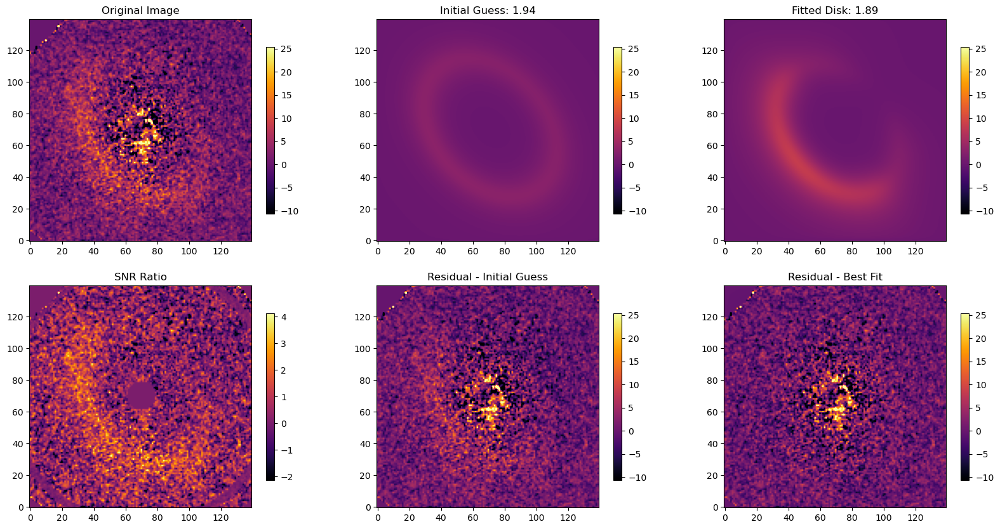

Radius             85.0
Inclination        88.0
Position Angle    293.9
Distance          131.5
Name: hd146897_H_pol, dtype: float64
Time taken: 0:00:23.030982
Optimization terminated successfully.
2 out of 19 done



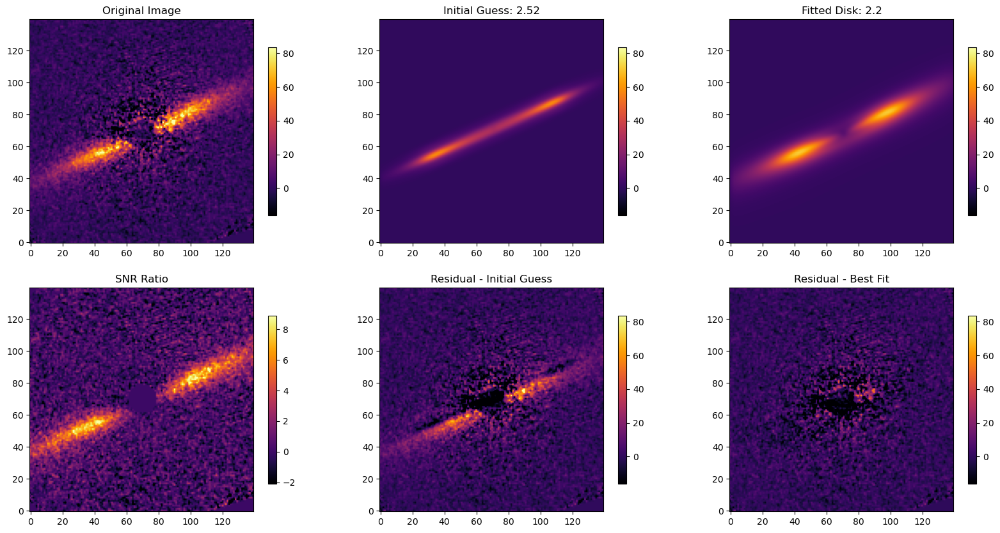

Radius             29.80
Inclination        13.10
Position Angle    271.00
Distance           34.03
Name: ceant_H_pol, dtype: float64
Time taken: 0:00:35.293389
Optimization terminated successfully.
3 out of 19 done



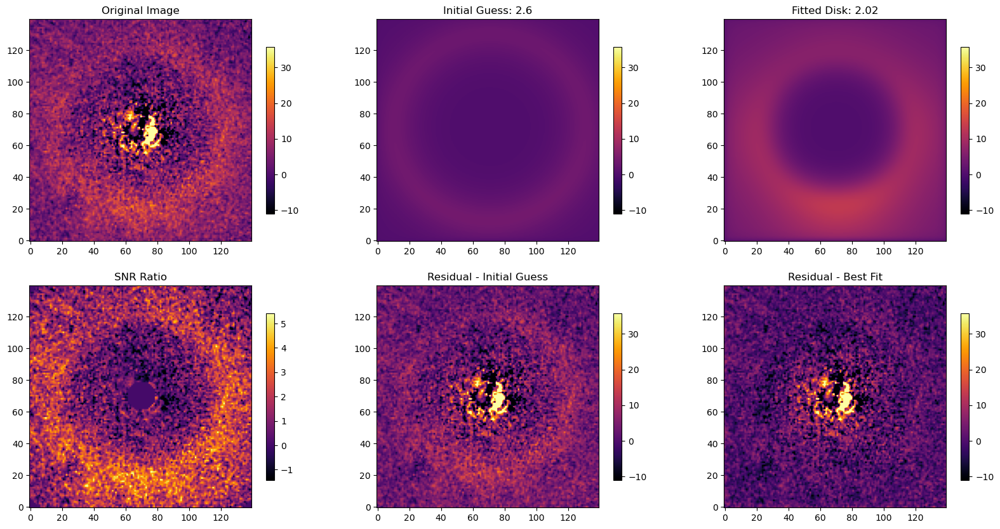

Radius             81.00
Inclination        88.00
Position Angle    165.00
Distance          108.94
Name: hd111520_H_pol, dtype: float64
Time taken: 0:01:32.547217
Optimization terminated successfully.
4 out of 19 done



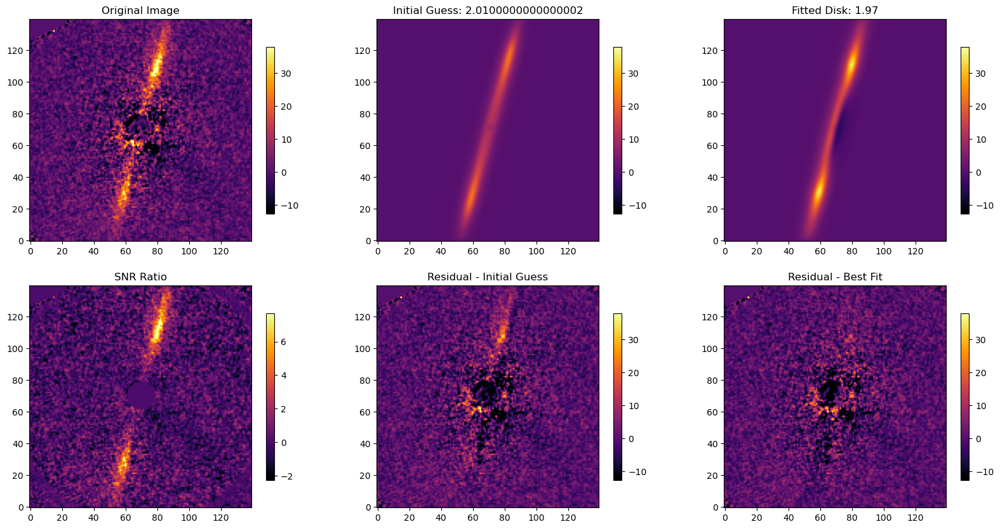

Radius             46.00
Inclination        80.00
Position Angle     27.50
Distance          109.62
Name: hd115600_H_pol, dtype: float64
Time taken: 0:00:14.677939
Optimization terminated successfully.
5 out of 19 done



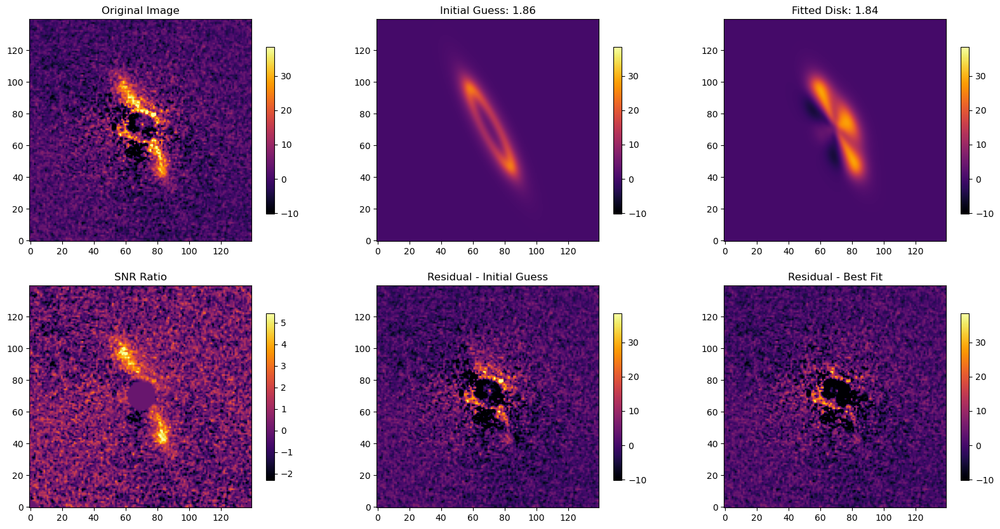

Radius             66.90
Inclination        75.70
Position Angle    121.70
Distance          136.04
Name: hd129590_H_pol, dtype: float64
Time taken: 0:00:53.038379
Optimization terminated successfully.
6 out of 19 done



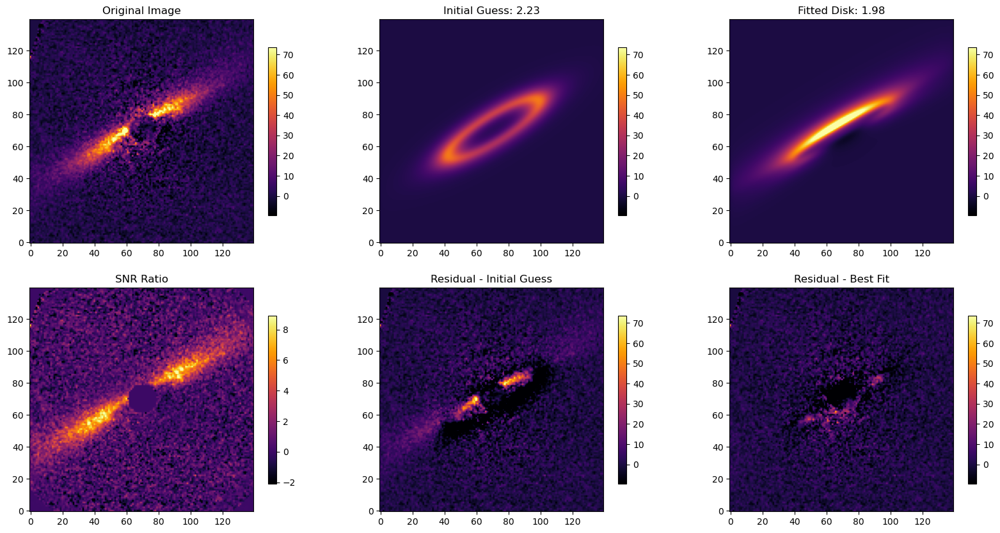

Radius             60.20
Inclination        71.00
Position Angle    359.80
Distance          107.61
Name: hd117214_H_pol, dtype: float64
Time taken: 0:00:34.070079
Optimization terminated successfully.
7 out of 19 done



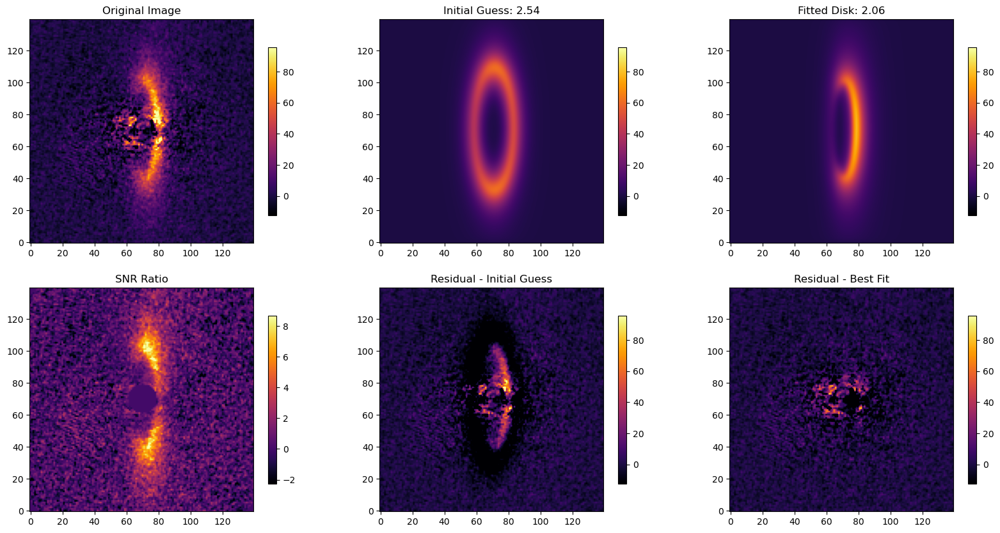

Radius             60.30
Inclination        84.90
Position Angle    345.80
Distance          103.68
Name: hd35841_H_pol, dtype: float64
Time taken: 0:00:24.857047
Optimization terminated successfully.
8 out of 19 done



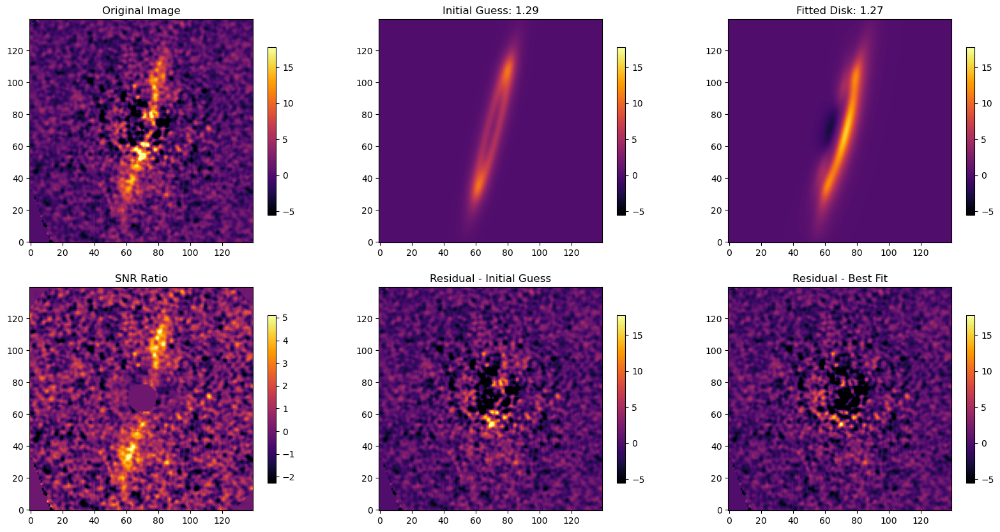

Radius            83.00
Inclination       83.00
Position Angle    32.30
Distance          80.54
Name: hd30447_H_pol, dtype: float64
Time taken: 0:00:28.665973
Optimization terminated successfully.
9 out of 19 done



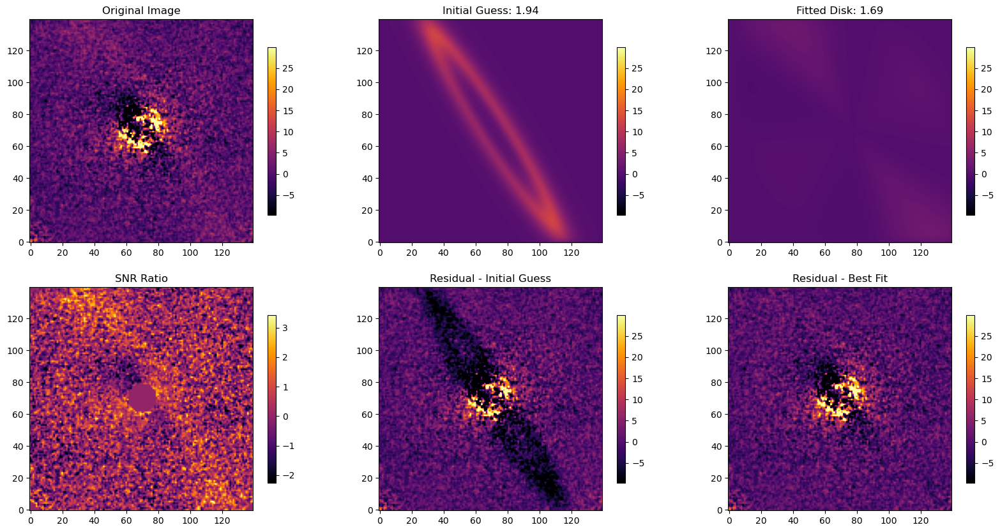

Radius             98.40
Inclination        87.40
Position Angle     47.90
Distance          132.79
Name: hd32297_H_pol, dtype: float64
Time taken: 0:00:16.695442
Optimization terminated successfully.
10 out of 19 done



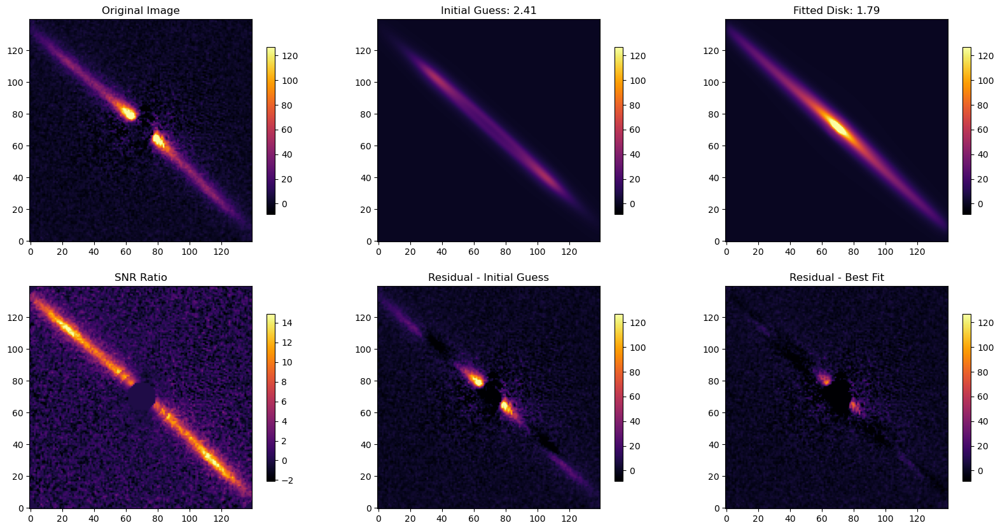

Radius             39.00
Inclination        84.00
Position Angle    335.00
Distance          129.98
Name: hd110058_H_pol, dtype: float64
Time taken: 0:00:08.950766
Optimization terminated successfully.
11 out of 19 done



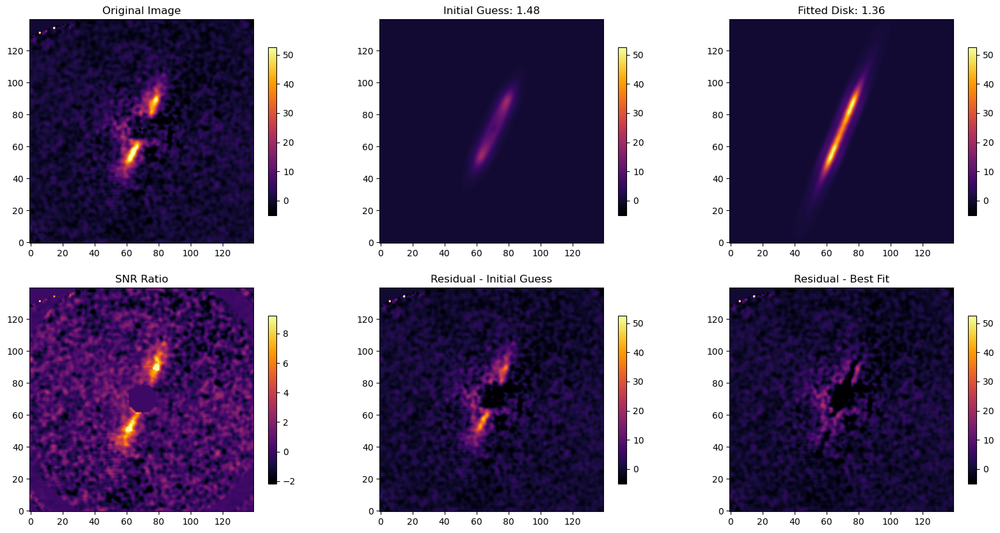

Radius             72.40
Inclination        62.10
Position Angle    263.20
Distance          109.43
Name: hd111161_H_pol, dtype: float64
Time taken: 0:00:20.095080
Optimization terminated successfully.
12 out of 19 done



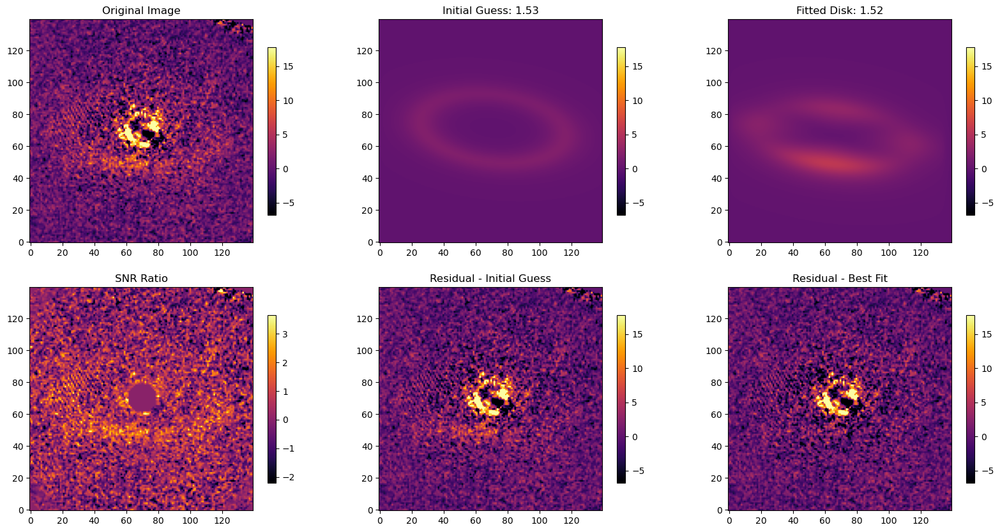

Radius             79.00
Inclination        70.00
Position Angle    127.00
Distance          100.51
Name: hd157587_H_pol, dtype: float64
Time taken: 0:00:48.247456
Optimization terminated successfully.
13 out of 19 done



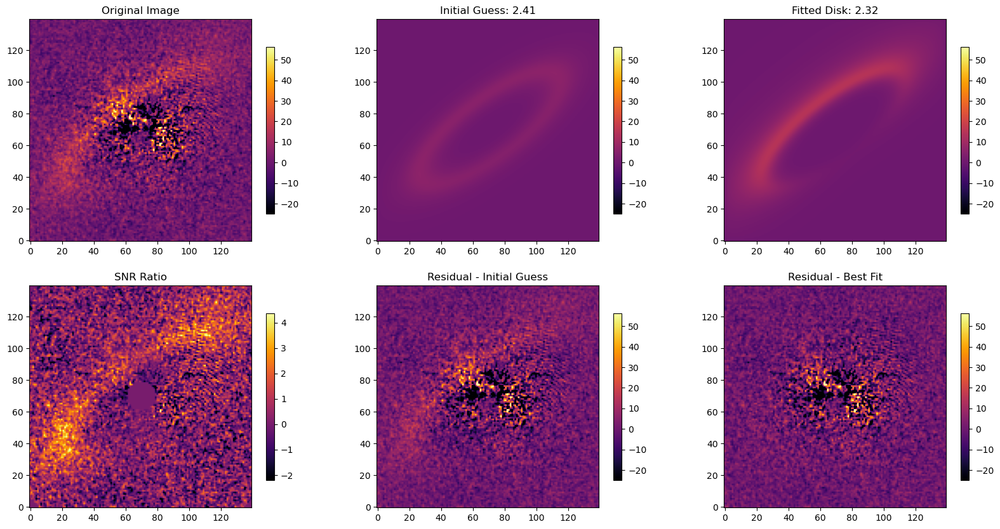

Radius            78.50
Inclination       76.50
Position Angle    26.10
Distance          72.78
Name: hr4796a_H_pol, dtype: float64
Time taken: 0:00:49.369168
Optimization terminated successfully.
14 out of 19 done



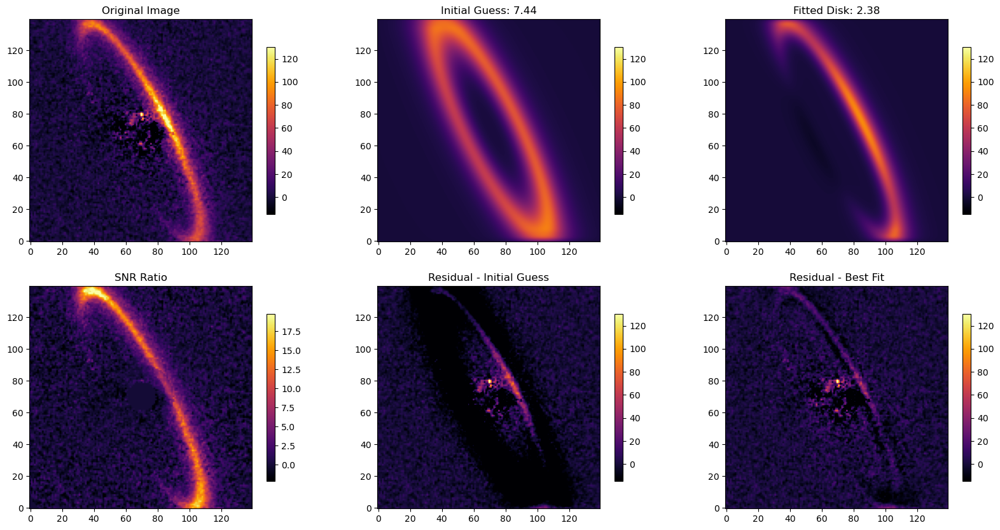

Radius            107.70
Inclination        75.10
Position Angle     61.40
Distance          133.65
Name: hd131835_H_pol, dtype: float64
Time taken: 0:00:54.433425
Optimization terminated successfully.
15 out of 19 done



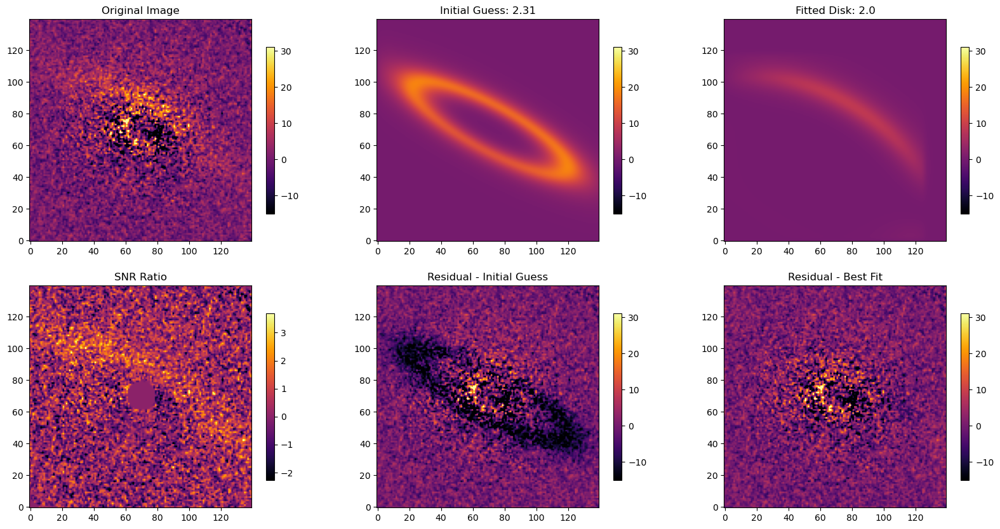

Radius             72.30
Inclination        84.60
Position Angle    104.20
Distance          103.33
Name: hd106906_H_pol, dtype: float64
Time taken: 0:00:17.831899
Optimization terminated successfully.
16 out of 19 done



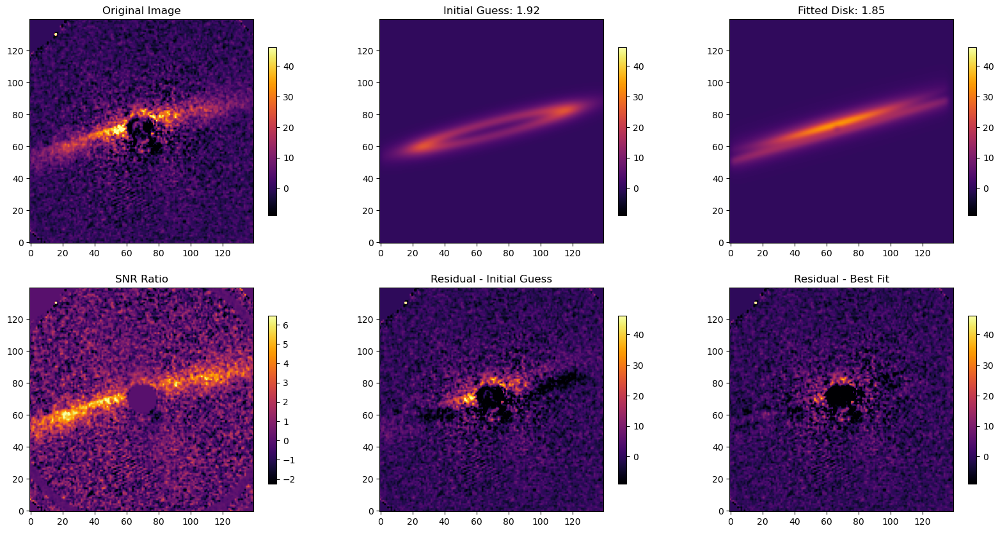

Radius             30.70
Inclination        83.30
Position Angle    285.70
Distance           95.65
Name: hd114082_H_pol, dtype: float64
Time taken: 0:00:12.244929
Optimization terminated successfully.
17 out of 19 done



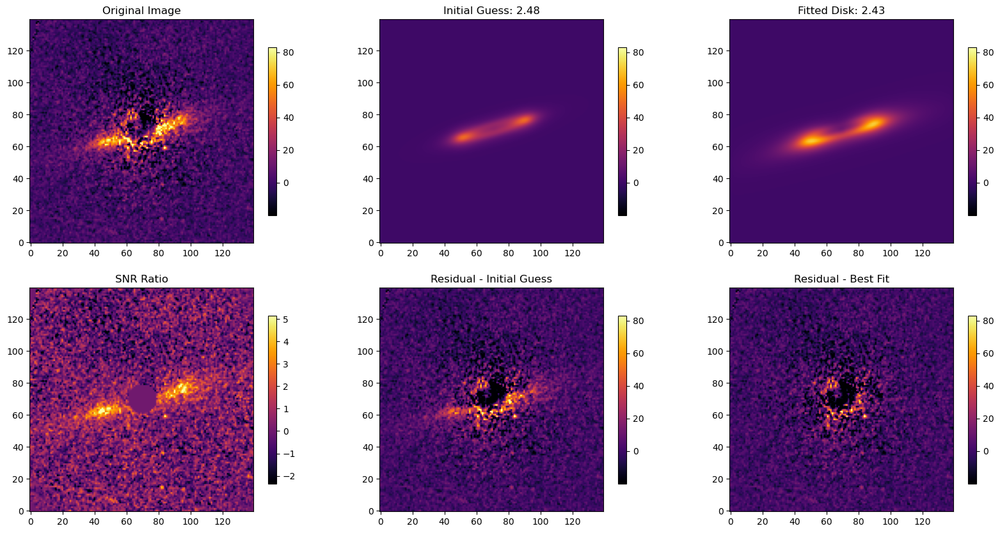

Radius            43.90
Inclination       59.00
Position Angle    70.00
Distance          50.13
Name: hd191089_H_pol, dtype: float64
Time taken: 0:00:49.565243
Optimization terminated successfully.
18 out of 19 done



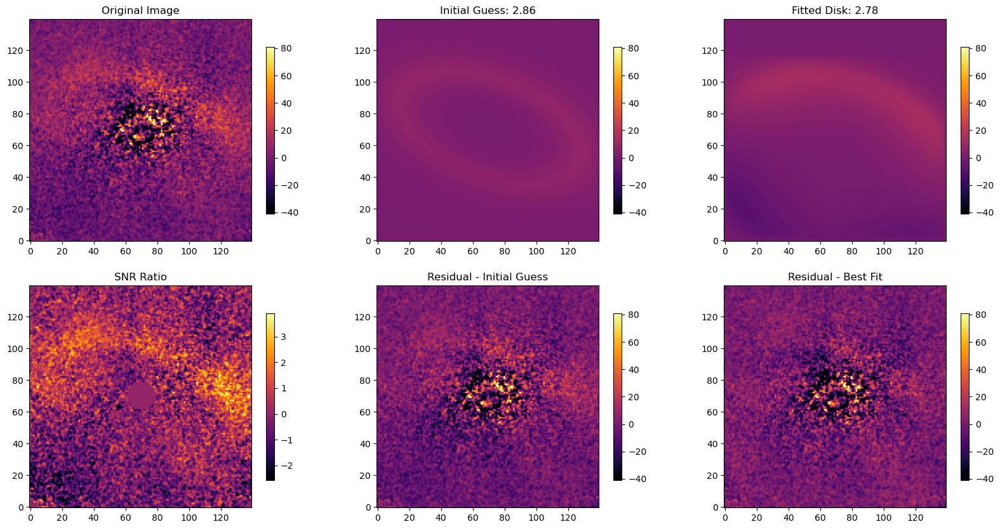

Radius             80.20
Inclination        34.90
Position Angle    280.90
Distance          111.75
Name: hd156623_H_pol, dtype: float64
Time taken: 0:00:10.093943
Optimization terminated successfully.
19 out of 19 done



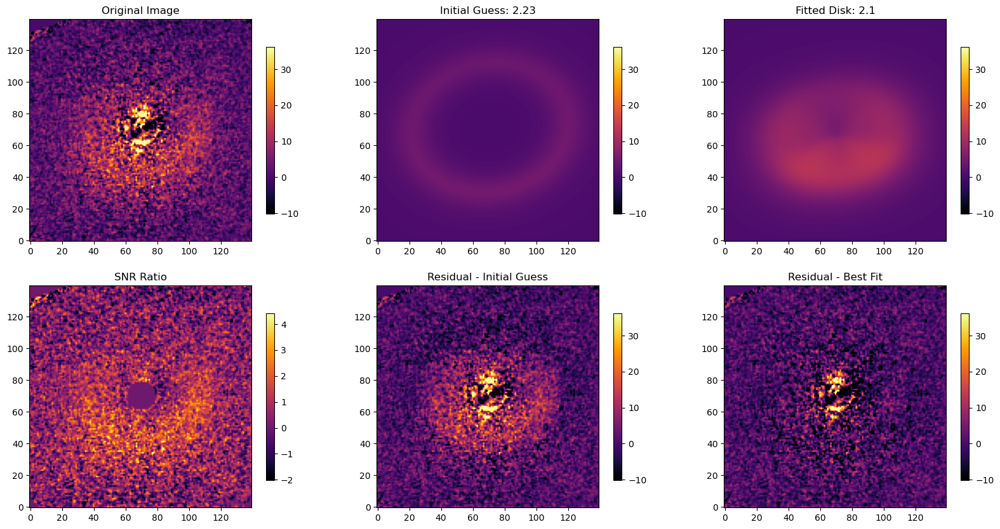

In [32]:
amnt = len(image_data)
ind = 0

for name, row in image_data.iterrows():
    print(row)
    hdul = fits.open("Fits/"+name+".fits")
    target_image = process_image(hdul['SCI'].data[1,:,:])
    err_map = create_empirical_err_map(process_image(hdul['SCI'].data[2,:,:])).astype(jnp.float64)
    sol = produce_image_fit(target_image, err_map, row["Radius"], row["Inclination"], row["Position Angle"], row["Distance"], dispTime=True)
    ind+=1
    print(sol.message)
    print(str(ind)+' out of '+str(amnt)+' done')
    print()
    plt.savefig("FitsResults/"+name+'.png')
    plt.show()

In [33]:
sol.message

'Optimization terminated successfully.'

## MCMC Model Time!

In [34]:
#from mcmc_model import MCMC_model

In [35]:
'''num_knots = 4

llp = lambda x: -log_likelihood_1d_full_opt(x, 
                    DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, 
                    1e6, target_image, err_map, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = 72.78,
                    knots=knots)


DISK_BOUNDS = np.array([np.array([-100, -100, 0, 0, 0]), np.array([200, 200, 100, 180, 180])])
CENT_AND_DISTR_BOUNDS = np.array([np.array([65, 65, -10, 0, 0, -200]), np.array([75, 75, 10, 10, 100, 100])])
SPLINE_BOUNDS = np.array([np.zeros(num_knots), 100*np.ones(num_knots)])
BOUNDS = np.array([np.concatenate([DISK_BOUNDS[0], CENT_AND_DISTR_BOUNDS[0], SPLINE_BOUNDS[0]]),
                    np.concatenate([DISK_BOUNDS[1], CENT_AND_DISTR_BOUNDS[1], SPLINE_BOUNDS[1]])])

start = datetime.now()
mc_model = MCMC_model(llp, BOUNDS)
mc_model.run(soln, nconst = 1e-7, nwalkers=500, niter=500, burn_iter=100)
labels = ['alpha_in', 'alpha_out', 'sma', 'inclination', 'position_angle', 'xc', 'yc', 'e', 'ksi', 'gamma', 'beta']
for i in range(0, num_knots):
    labels.append('k'+str(i+1))
mc_model.show_corner_plot(labels, truths=soln)
end = datetime.now()
print(end-start)'''

"num_knots = 4\n\nllp = lambda x: -log_likelihood_1d_full_opt(x, \n                    DustEllipticalDistribution2PowerLaws, InterpolatedUnivariateSpline_SPF, \n                    1e6, target_image, err_map, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = 72.78,\n                    knots=knots)\n\n\nDISK_BOUNDS = np.array([np.array([-100, -100, 0, 0, 0]), np.array([200, 200, 100, 180, 180])])\nCENT_AND_DISTR_BOUNDS = np.array([np.array([65, 65, -10, 0, 0, -200]), np.array([75, 75, 10, 10, 100, 100])])\nSPLINE_BOUNDS = np.array([np.zeros(num_knots), 100*np.ones(num_knots)])\nBOUNDS = np.array([np.concatenate([DISK_BOUNDS[0], CENT_AND_DISTR_BOUNDS[0], SPLINE_BOUNDS[0]]),\n                    np.concatenate([DISK_BOUNDS[1], CENT_AND_DISTR_BOUNDS[1], SPLINE_BOUNDS[1]])])\n\nstart = datetime.now()\nmc_model = MCMC_model(llp, BOUNDS)\nmc_model.run(soln, nconst = 1e-7, nwalkers=500, niter=500, burn_iter=100)\nlabels = ['alpha_in', 'alpha_out', 'sma', 'inclination', 'position_angle', 'xc'

In [36]:
'''fig, axes = plt.subplots(5,3, figsize=(20,20))
fig.subplots_adjust(hspace=0.5)

for i in range(0, 5):
    for j in range(0, 3):
        axes[i][j].plot(np.linspace(0, 500, 500), mc_model.sampler.get_chain()[:, :, 3*i+j].T)
        axes[i][j].set_title(labels[3*i+j])'''

'fig, axes = plt.subplots(5,3, figsize=(20,20))\nfig.subplots_adjust(hspace=0.5)\n\nfor i in range(0, 5):\n    for j in range(0, 3):\n        axes[i][j].plot(np.linspace(0, 500, 500), mc_model.sampler.get_chain()[:, :, 3*i+j].T)\n        axes[i][j].set_title(labels[3*i+j])'

In [37]:
'''mc_soln = mc_model.get_theta_max()
mc_image = quick_image_full_opt(mc_soln, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = 72.78, knots=knots)

fig, axes = plt.subplots(1,3, figsize=(20,10))

im = axes[0].imshow(target_image, origin='lower', cmap='inferno')
axes[0].set_title("Original Image")
plt.colorbar(im, ax=axes[0], shrink=0.75)

im = axes[1].imshow(mc_image, origin='lower', cmap='inferno')
axes[1].set_title("MCMC Fitted Image")
plt.colorbar(im, ax=axes[1], shrink=0.75)

im = axes[2].imshow(target_image-mc_image, origin='lower', cmap='inferno')
axes[2].set_title("Final Image - MCMC Fitted Image")
plt.colorbar(im, ax=axes[2], shrink=0.75)'''

'mc_soln = mc_model.get_theta_max()\nmc_image = quick_image_full_opt(mc_soln, PSFModel = EMP_PSF, pxInArcsec=0.01414, distance = 72.78, knots=knots)\n\nfig, axes = plt.subplots(1,3, figsize=(20,10))\n\nim = axes[0].imshow(target_image, origin=\'lower\', cmap=\'inferno\')\naxes[0].set_title("Original Image")\nplt.colorbar(im, ax=axes[0], shrink=0.75)\n\nim = axes[1].imshow(mc_image, origin=\'lower\', cmap=\'inferno\')\naxes[1].set_title("MCMC Fitted Image")\nplt.colorbar(im, ax=axes[1], shrink=0.75)\n\nim = axes[2].imshow(target_image-mc_image, origin=\'lower\', cmap=\'inferno\')\naxes[2].set_title("Final Image - MCMC Fitted Image")\nplt.colorbar(im, ax=axes[2], shrink=0.75)'

In [38]:
#print(-llp(mc_soln))